#### Importing all the required **Python** and **R** libraries 

In [1]:
import pandas as pd
import scanpy as sc
import warnings
import scarches as sca
warnings.filterwarnings("ignore")

import decoupler as dc

import sys
sys.path.append('../scripts')
%load_ext autoreload
%autoreload 2
from sklearn_ann.kneighbors.annoy import AnnoyTransformer
#%load_ext lab_black

/home/daniele/miniconda3/envs/scmouse_atlas/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


In [2]:
sc.set_figure_params(frameon=False)
sc.settings.figdir = '/home/daniele/Code/scmouse_atlas/reports/figures/'

In [2]:
adata = sc.read_h5ad('/mnt/storage/Daniele/atlases/mouse/06_mouse_inhouse_integrated_scanvi.h5ad')

In [3]:
sc.pp.neighbors(adata, use_rep = 'X_scANVI', transformer=AnnoyTransformer(30))

In [4]:
sc.tl.umap(adata, min_dist=0.2)

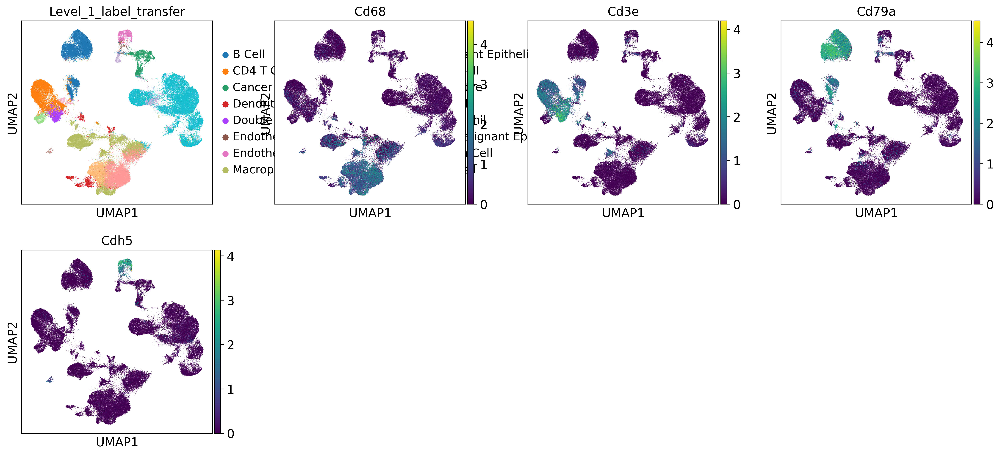

In [5]:
sc.pl.umap(adata, color = ['Level_1_label_transfer', 'Cd68', 'Cd3e', 'Cd79a','Cdh5'], layer='log_norm')

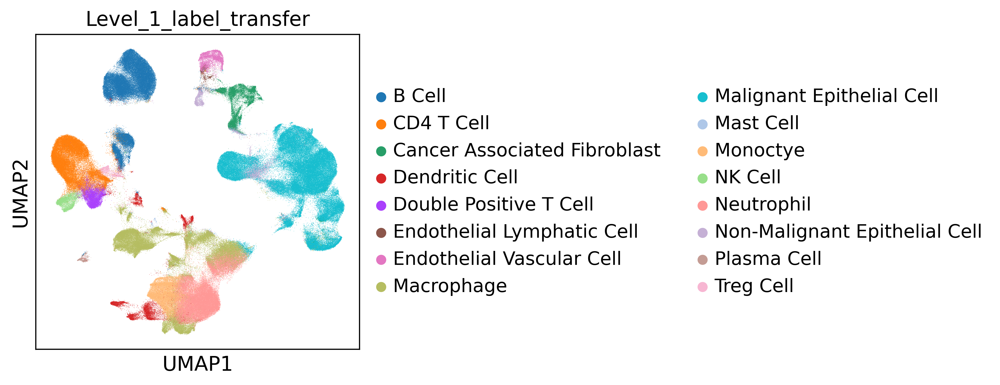

In [6]:
sc.pl.umap(adata, color = ['Level_1_label_transfer'])

In [7]:
sc.tl.leiden(adata, resolution=1, flavor='igraph', key_added='leiden_1.0')

In [61]:
sc.tl.rank_genes_groups(adata, groupby='leiden_1.0', layer='log_norm')
sc.tl.dendrogram(adata, groupby='leiden_1.0', use_rep='X_scANVI')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, values_to_plot='logfoldchanges', vmin=-5, vmax=5, min_logfoldchange=2, cmap='coolwarm', dendrogram=True)

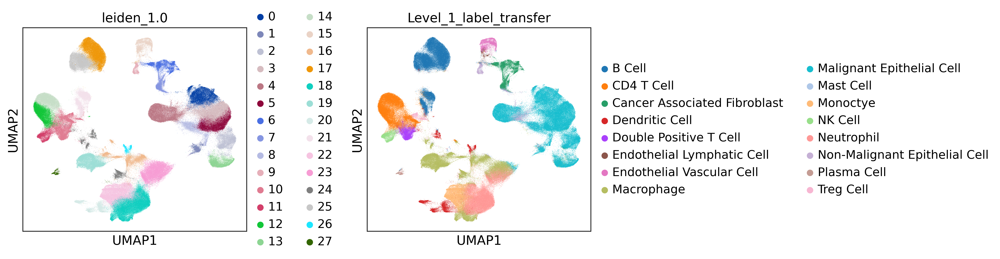

In [9]:
sc.pl.umap(adata, color = ['leiden_1.0', 'Level_1_label_transfer'], layer = 'log_norm', wspace=.4)

In [2]:
adata = sc.read_h5ad('/mnt/storage/Daniele/atlases/mouse/07_mouse_inhouse_integrated_scanvi_refined.h5ad')

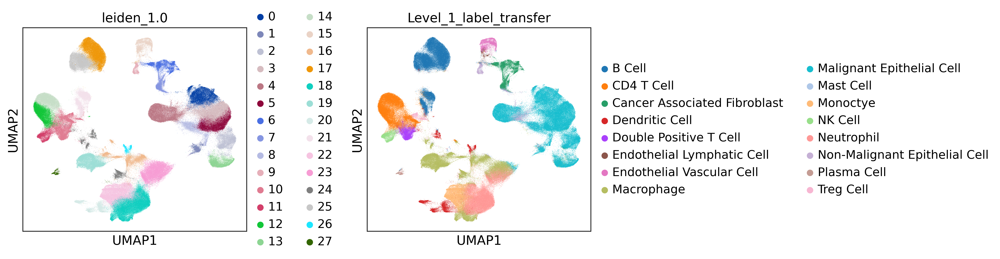

In [4]:
sc.pl.umap(adata, color = ['leiden_1.0', 'Level_1_label_transfer'], layer = 'log_norm', wspace=.4)

In [10]:
level_1_markers = {
    "Adipocyte": ["Plin1", "Lpl"],
    "Pancreatic stellate cells": ["Des", "Dcn"],
    "Cancer associated fibroblasts": ["Col6a3", "Col1a1", "Thbs2", "Fn1", "Pdpn", "Dcn", "Vim", "Fap"],
    "Endothelial": ["Pecam1", "Vwf"],
    "Intra-pancreatic neurons": ["Eno2", "Chat", "Th"],
    "Pericyte/Vascular Smooth Muscle": ["Pdgfrb", "Dlk1", "Rgs5", "Cspg4", "Mcam",],
    "Schwann": ["Sox10", "S100b"],
    "Endocrine": ["Chga", "Syp"],
    "Malignant epithelial cells": ["Krt7", "Krt17", "Krt19", "Epcam"],
    "CD4+ T cells": ["Cd4", "Cd3d", "Themis"],
    "CD8+ T cells": ["Cd8a"],
    "Treg cells": ["Foxp3", "Il2ra"],
    "NK cells": ["Klrd1", "Il18r1"],
    "Plasma cells": ["Sdc1", "Iglc2"],
    "B cells": ["Bank1", "Cd19", "Cd74", "Ms4a1"],
    "Neutrophil": ["Csf3r", "S100a8"],
    "Macrophage": ["Cd68", "Cd163", "Mrc1", "Cd80", "Cd86", "Tgfb1", "Csf1"],
    "Monocyte": ["Tlr2", "Itgb2", "Itgam", "Ctsd", "Ctsa", "Nlrp3", "Bst1", "Stab1", "Irak3"],
    "Mast": ["Cpa3", "Kit"],
    "Dendritic (activated)": ["Fscn1", "Lamp3", "Ccl19", "Ccr7"],
    "Dendritic (conventional type 1)": ["Cst3", "Clec9a", "Lgals2", "Xcr1"],
    "Dendritic (conventional type 2)": ["Cd207", "Ndrg2", "Fcer1a", ],
    "Dendritic (plasmacytoid)": ["Irf7", "Tcf4", "Irf4", "Gzmb", "Cxcr3"]
}


categories: 0, 1, 2, etc.
var_group_labels: Adipocyte, Pancreatic stellate cells, Cancer associated fibroblasts, etc.


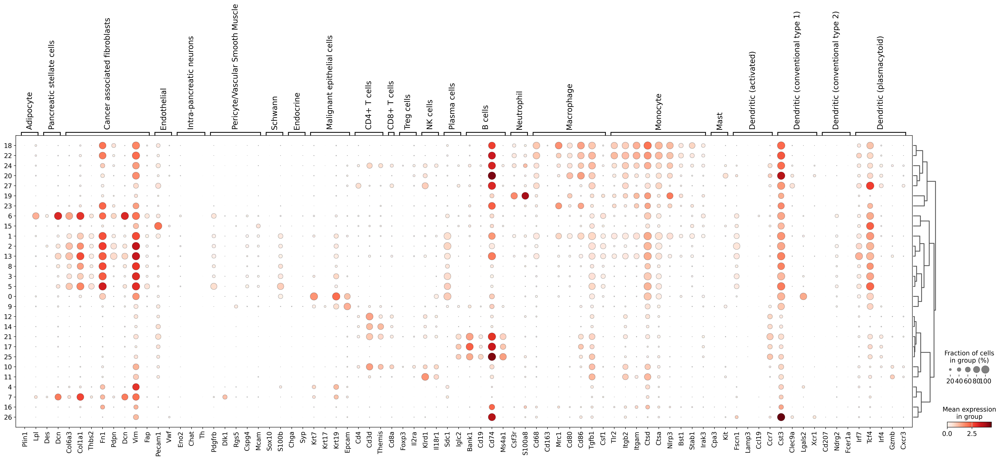

In [11]:
sc.tl.dendrogram(adata, groupby='leiden_1.0', use_rep='X_scANVI')
sc.pl.dotplot(adata, var_names=level_1_markers, groupby='leiden_1.0', use_raw=False, layer='log_norm', dendrogram=True)

In [68]:
adata.obs['Level_1_refined'] = adata.obs['leiden_1.0'].map(anno).astype('category')

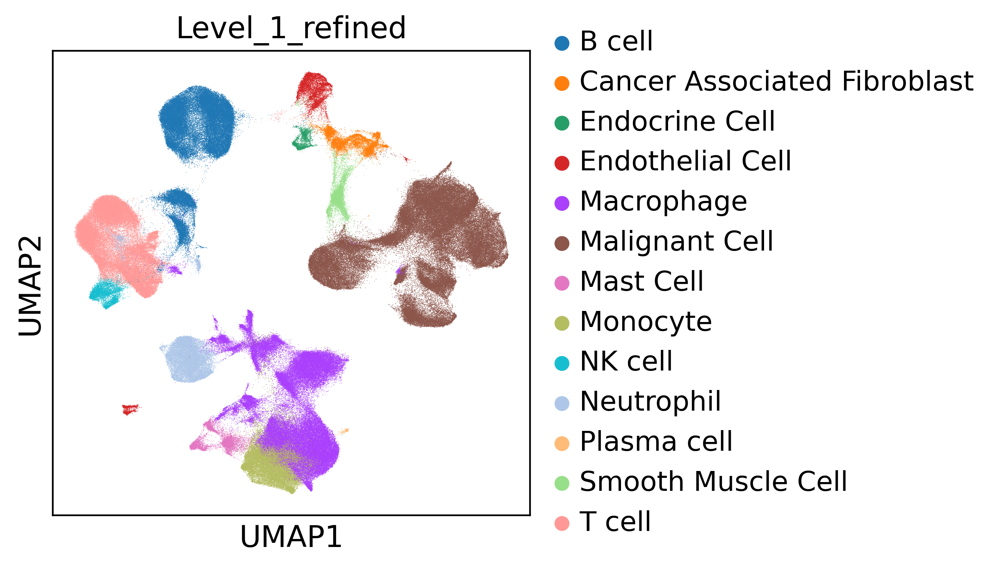

In [70]:
sc.pl.umap(adata, color = ['Level_1_refined'])

In [71]:
adata.write('/mnt/storage/Daniele/atlases/mouse/07_mouse_inhouse_integrated_scanvi_refined.h5ad')